# Explanations

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
from PIL import Image
import torch.nn as nn
import numpy as np
import os, json

import torch
from torchvision import models, transforms
from torch.autograd import Variable
import torch.nn.functional as F
from skimage.segmentation import mark_boundaries

from lime import lime_image
from lime import lime_video

from tqdm.auto import tqdm
import copy
import cv2

import torch, torchvision
import mmcv
from mmcv import Config
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
import mmaction
from mmaction.apis import inference_recognizer, init_recognizer
from mmaction.datasets import build_dataset
from matplotlib import pyplot as plt
import decord as de

In [3]:
def batch_predict(videos, verbose=False, topk=5, read_folder=None):
    results = []
    for video in videos:
        if read_folder is not None:
            video = np.load(os.path.join(read_folder, str(video)+'.npy'))
        if verbose:
            results_k = inference_recognizer(model, video, topk_results=topk)
            results_k = [(labels[k[0]], k[1]) for k in results_k]
            # Let's show the results
            for result in results_k:
                print(f'{result[0]}: ', result[1])
            print('----------------------------------------')
        else:
            results.append(inference_recognizer(model, video))
    return np.array(results)

def show_video(video, boundry=None, bgr=True):
    for n_frame in range(video.shape[0]):
        
        frame = cv2.cvtColor(video[n_frame,:,:,:], cv2.COLOR_BGR2RGB) if bgr else video[n_frame,:,:,:]
        if boundry is not None:
            frame = (mark_boundaries(frame/255.0, boundry[n_frame,:,:])*255).astype('uint8')
            
        k = cv2.waitKey(20) & 0xFF
        if k == ord('q') or k == 27:
                break
        cv2.imshow('frame', frame)
    cv2.destroyAllWindows()
    
def save_video(video, path, video_name, boundry=None, fps=30, bgr=True):
    out = cv2.VideoWriter(os.path.join(path, video_name), cv2.VideoWriter_fourcc(*'DIVX'), fps, video.shape[1:3][::-1])
    for n_frame in range(video.shape[0]):
        frame = cv2.cvtColor(video[n_frame,:,:,:], cv2.COLOR_BGR2RGB) if bgr else video[n_frame,:,:,:]
        if boundry is not None:
            frame = (mark_boundaries(frame/255.0, boundry[n_frame,:,:])*255).astype('uint8')
        out.write(frame)
    out.release()

def resize_video(video, scale_x, scale_y):
    new_w = int(video.shape[2]*scale_x)
    new_h = int(video.shape[1]*scale_y)
    video_out = np.zeros(shape=(video.shape[0], new_h, new_w, 3), dtype='uint8')
    
    for i in range(video.shape[0]):
        frame = video[i,:,:,:]
        video_out[i,:,:,:] = cv2.resize(frame, dsize=(new_w, new_h))
        
    return video_out

## Load model, test videos and video sample

In [4]:
config = 'mmaction2/configs/recognition/timesformer/timesformer_divST_8x32x1 - modified pipeline.py'
checkpoint = 'training_logs/3r entrenament/epoch_10.pth'
model = init_recognizer(config, checkpoint, device='cuda:0')
labels = [x.strip() for x in open("label_map_EtriActivity3D.txt").readlines()]

# video_path = "E:/OneDrive - Universitat de les Illes Balears/2021-2022/TFM/videos_demo/A003_P042_G003_C003.mp4" #'mmaction2/demo/demo.mp4'
video_path = "F:\\ETRI-Activity3D\\RGB Videos\\EtriActivity3D\\all_videos\\A003_P042_G003_C003.mp4" #'mmaction2/demo/demo.mp4'
explanations_path = "E:/OneDrive - Universitat de les Illes Balears/2021-2022/TFM/video_explanations2"

test_videos_path = "F:/ETRI-Activity3D/RGB Videos/EtriActivity3D/all_videos"
test_file = "F:/ETRI-Activity3D/RGB Videos/EtriActivity3D/EtriActivity3D_test_k1_video.txt"

load checkpoint from local path: training_logs/3r entrenament/epoch_10.pth


In [5]:
# Load video names and labels from test file
test_tuples = [x.split() for x in open(test_file).readlines()]
test_videos = [[] for _ in range(55)]
for video_name, label in test_tuples:
    label = int(label)
    test_videos[label].append(video_name)
    
video_path = os.path.join(test_videos_path, test_videos[2][0])
print("Video sample:", video_path)

# Load video
vr = de.VideoReader(video_path)
in_video = vr.get_batch(range(0, len(vr), 1)).asnumpy()

# Resize for faster computation and better visuzlization
target_w = 512
scale_factor = target_w / in_video.shape[2]
resized_in_video = resize_video(in_video, scale_factor, scale_factor)

# Set explanation size
target_explan_w = 256
explan_scale_factor = target_explan_w / resized_in_video.shape[2]

Video sample: F:/ETRI-Activity3D/RGB Videos/EtriActivity3D/all_videos\A003_P042_G003_C003.mp4


## Space explanations

### 2D

In [25]:
# Set explanation size
target_explan_w = 256
explan_scale_factor = target_explan_w / resized_in_video.shape[2]

video_explainer = lime_video.LimeVideoExplainer()
explanation = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 500, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "space",
                                               seg_width_slices = 20,
                                               seg_height_slices= 10) 

  0%|          | 0/500 [00:00<?, ?it/s]

Score map:

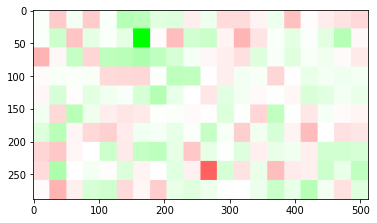

In [24]:
# 100
score_map = explanation.get_score_map(explanation.top_labels[0])
plt.imshow(explanation.get_score_map_rgb(score_map)[0,:,:,:])
plt.show()

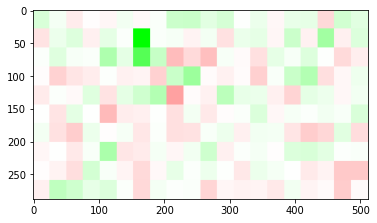

In [20]:
# 200
score_map = explanation.get_score_map(explanation.top_labels[0])
plt.imshow(explanation.get_score_map_rgb(score_map)[0,:,:,:])
plt.show()

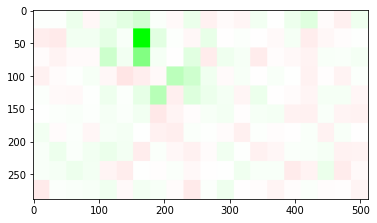

In [27]:
# 500
score_map = explanation.get_score_map(explanation.top_labels[0])
plt.imshow(explanation.get_score_map_rgb(score_map)[0,:,:,:])
plt.show()

In [8]:
masked_video = explanation.get_masked_video(score_map)
# save_video(masked_video, path=explanations_path, video_name="space_explanations.mp4", bgr=False)
# show_video(masked_video, bgr=False)

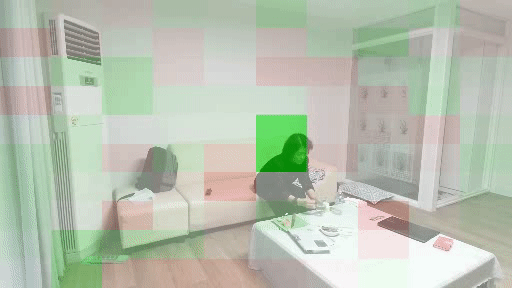

### 1D: X

In [6]:
# Set explanation size
target_explan_w = 256
explan_scale_factor = target_explan_w / resized_in_video.shape[2]

video_explainer = lime_video.LimeVideoExplainer()
explan_x = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 50, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "space",
                                               seg_width_slices = 20,
                                               seg_height_slices= 1) 

  0%|          | 0/50 [00:00<?, ?it/s]

Score map:

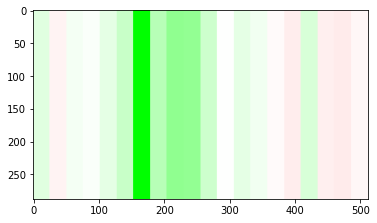

In [35]:
# 50
score_map = explan_x.get_score_map(explan_x.top_labels[0])
plt.imshow(explan_x.get_score_map_rgb(score_map)[0,:,:,:])
plt.show()

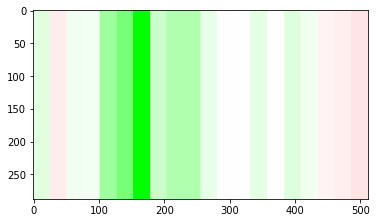

In [37]:
# 100
score_map = explan_x.get_score_map(explan_x.top_labels[0])
plt.imshow(explan_x.get_score_map_rgb(score_map)[0,:,:,:])
plt.show()

### 1D: Y

In [7]:
# Set explanation size
target_explan_w = 256
explan_scale_factor = target_explan_w / resized_in_video.shape[2]

video_explainer = lime_video.LimeVideoExplainer()
explan_y = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 50, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "space",
                                               seg_width_slices = 1,
                                               seg_height_slices= 10) 

  0%|          | 0/50 [00:00<?, ?it/s]

Score map:

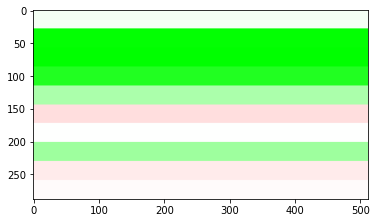

In [45]:
# 50
score_map = explan_y.get_score_map(explan_y.top_labels[0])
plt.imshow(explan_y.get_score_map_rgb(score_map)[0,:,:,:])
plt.show()

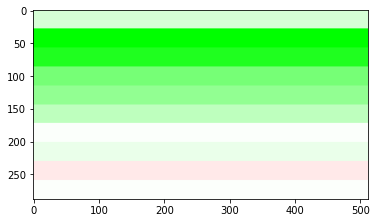

In [43]:
# 100
score_map = explan_y.get_score_map(explan_y.top_labels[0])
plt.imshow(explan_y.get_score_map_rgb(score_map)[0,:,:,:])
plt.show()

### 2D: Joined Space

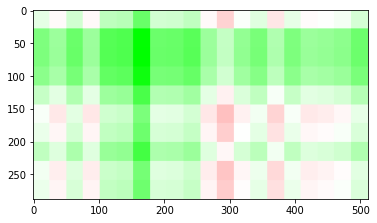

In [47]:
scores_space_xy = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [explan_x, explan_y], [0.5, 0.5], method='arithmetic')
plt.imshow(lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, scores_space_xy)[0,:,:,:])
plt.show()

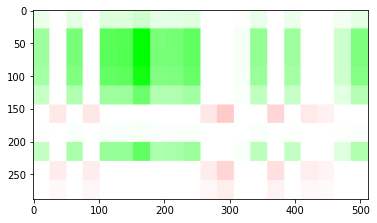

In [48]:
scores_space_xy = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [explan_x, explan_y], [0.5, 0.5], method='geometric')
plt.imshow(lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, scores_space_xy)[0,:,:,:])
plt.show()

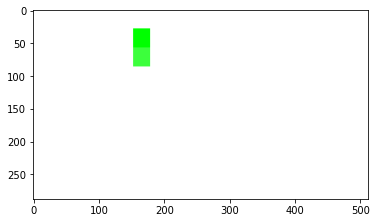

In [12]:
# th=0
scores_space_xy = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [explan_x, explan_y], [0.5, 0.5], method='harmonic', top_k=round(20*10*0.01))
plt.imshow(lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, scores_space_xy)[0,:,:,:])
plt.show()

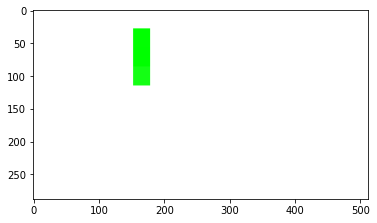

In [62]:
# th=0.2
scores_space_xy = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [explan_x, explan_y], [0.5, 0.5], method='harmonic', th=0.2)
plt.imshow(lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, scores_space_xy)[0,:,:,:])
plt.show()

## Time explanations

### Using blackened frames

In [63]:
video_explainer = lime_video.LimeVideoExplainer()
explan_t = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 50, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "time-blackened",
                                               seg_width_slices = 10,
                                               seg_height_slices= 10,
                                               seg_time_slices = 10) 

  0%|          | 0/50 [00:00<?, ?it/s]

Score map:

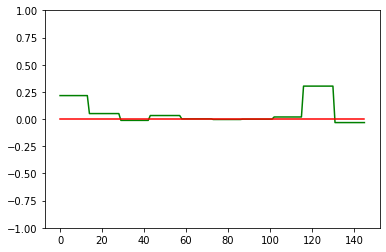

In [64]:
# 50
score_map = explan_t.get_score_map(explan_t.top_labels[0])
expl = score_map[:, 0, 0]
plt.plot(expl, color='green')
plt.plot([0]*expl.shape[0], color='red')
plt.ylim([-1, 1])
plt.show()

In [22]:
masked_video = explanation.get_masked_video(score_map)
# save_video(masked_video, path=explanations_path, video_name="time-blackened_explanations.mp4", bgr=False)
# show_video(masked_video, bgr=False)

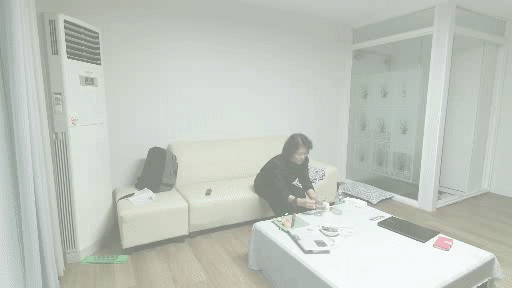

### Using clipped parts of the video

In [32]:
video_explainer = lime_video.LimeVideoExplainer()
explanation = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 100, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "time-clipped",
                                               seg_width_slices = 10,
                                               seg_height_slices= 10,
                                               seg_time_slices = 10) 

  0%|          | 0/11 [00:00<?, ?it/s]

Score map:

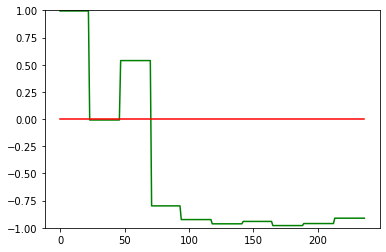

In [33]:
expl = explanation.get_score_map(explanation.top_labels[0])[:, 0, 0]
plt.plot(expl, color='green')
plt.plot([0]*expl.shape[0], color='red')
plt.ylim([-1, 1])
plt.show()

### Using freezed frame as video

In [60]:
video_explainer = lime_video.LimeVideoExplainer()
explanation = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 100, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "time-freeze",
                                               seg_width_slices = 10,
                                               seg_height_slices= 10,
                                               seg_time_slices = 10) 

  0%|          | 0/11 [00:00<?, ?it/s]

Score map:

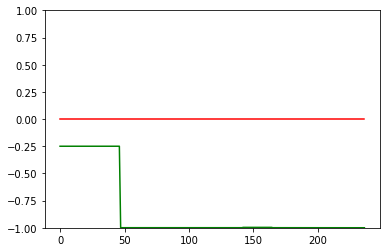

In [61]:
expl = explanation.get_score_map(explanation.top_labels[0])[:, 0, 0]
plt.plot(expl, color='green')
plt.plot([0]*expl.shape[0], color='red')
plt.ylim([-1, 1])
plt.show()

## Space-Time explanations

In [68]:
video_explainer = lime_video.LimeVideoExplainer()
explanation = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 2000, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "space-time",
                                               seg_width_slices = 20,
                                               seg_height_slices= 10,
                                               seg_time_slices = 10) 

  0%|          | 0/2000 [00:00<?, ?it/s]

Score map:

In [69]:
score_map = explanation.get_score_map(explanation.top_labels[0])
expl = explanation.get_score_map_rgb(score_map)
save_video(expl, path=explanations_path, video_name="space-time_scores_2000.mp4", bgr=True)
# show_video(expl, bgr=True)

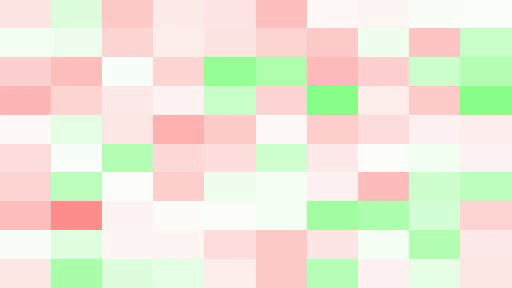

In [ ]:
masked_video = explanation.get_masked_video(score_map)
# save_video(masked_video, path=explanations_path, video_name="space-time_explanations_1000.mp4", bgr=False)
# show_video(masked_video, bgr=False)

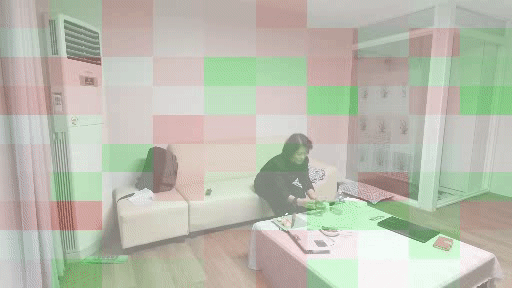

## Joined Space-Time explanations

In [46]:
video_explainer = lime_video.LimeVideoExplainer()
space_expl = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 500, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "space",
                                               seg_width_slices = 20,
                                               seg_height_slices= 10,
                                               seg_time_slices = 10) 

video_explainer = lime_video.LimeVideoExplainer()
time_expl = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 50, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "time-blackened",
                                               seg_width_slices = 10,
                                               seg_height_slices= 10,
                                               seg_time_slices = 10) 

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Score map:

In [59]:
score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [space_expl, time_expl], [0.5, 0.5], method='harmonic')
score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
save_video(score_map_rgb, path=explanations_path, video_name="joined-space-time_scores-harmonic.mp4", bgr=True)
# show_video(score_map_rgb, bgr=True)

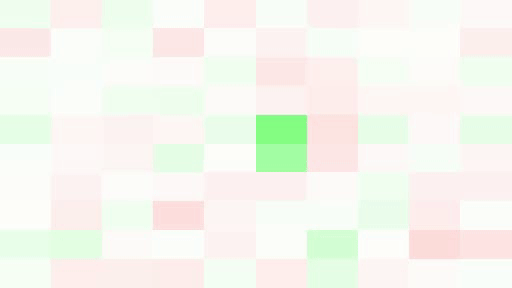

In [63]:
masked_video = lime_video.LimeVideoExplainer.mask_video(resized_in_video, score_map_rgb)
save_video(masked_video, path=explanations_path, video_name="joined-space-time_explanations.mp4", bgr=False)
# show_video(masked_video, bgr=False)

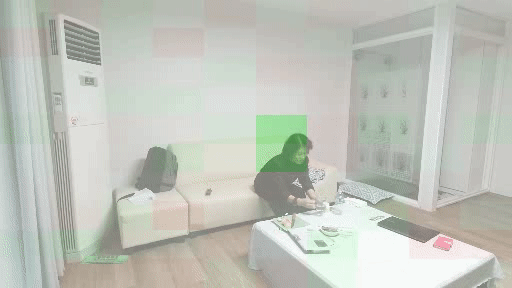

## Joined SpaceX-SpaceY-Time explanations

In [6]:
# Set explanation size
target_explan_w = 256
explan_scale_factor = target_explan_w / resized_in_video.shape[2]

video_explainer = lime_video.LimeVideoExplainer()
explan_x = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 100, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "space",
                                               seg_width_slices = 10,
                                               seg_height_slices= 1) 

video_explainer = lime_video.LimeVideoExplainer()
explan_y = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 100, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "space",
                                               seg_width_slices = 1,
                                               seg_height_slices= 10) 

video_explainer = lime_video.LimeVideoExplainer()
explan_t = video_explainer.explain_instance(resized_in_video, 
                                               classifier_fn = batch_predict, # classification function
                                               top_labels = 1, 
                                               hide_color = 0, 
                                               num_samples = 100, # number of videos that will be sent to classification function
                                               resize_scale = explan_scale_factor,
                                               segmentation_mode = "time-blackened",
                                               seg_width_slices = 10,
                                               seg_height_slices= 10,
                                               seg_time_slices = 10) 

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

  0%|          | 0/100 [00:00<?, ?it/s]

Score map:

In [41]:
scores_xyt = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [explan_x, explan_y, explan_t], [0.33, 0.33, 0.33], method='harmonic', th=0.1)
score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, scores_xyt)
save_video(score_map_rgb, path=explanations_path, video_name="joined-spaceX-spaceY-time_scores-harmonic.mp4", bgr=True)

In [45]:
masked_video = lime_video.LimeVideoExplainer.mask_video(resized_in_video, score_map_rgb)
save_video(masked_video, path=explanations_path, video_name="joined-spaceX-spaceY-time_explanations.mp4", bgr=False)

## Batch explanations

In [7]:
expl_save_folder = "E:/OneDrive - Universitat de les Illes Balears/2021-2022/TFM/batch_explanations"
test_videos_path = "F:/ETRI-Activity3D/RGB Videos/EtriActivity3D/all_videos"
test_file = "F:/ETRI-Activity3D/RGB Videos/EtriActivity3D/EtriActivity3D_test_k1_video.txt"

In [8]:
# T, X, Y, X+Y, X+Y+T
def explain_instance(video_path, out_path):
    
    # Load video
    vr = de.VideoReader(video_path)
    in_video = vr.get_batch(range(0, len(vr), 1)).asnumpy()

    # Resize for faster computation and better visuzlization
    target_w = 512
    scale_factor = target_w / in_video.shape[2]
    resized_in_video = resize_video(in_video, scale_factor, scale_factor)

    # Set explanation size
    target_explan_w = 256
    explan_scale_factor = target_explan_w / resized_in_video.shape[2]
    
    # Print predictions to text file
    with open(os.path.join(out_path, 'predictions.txt'), 'a') as f:
        results = inference_recognizer(model, in_video, topk_results=5)
        results = [(labels[k[0]], k[1]) for k in results]
        for class_name, score in results:
            f.write(class_name + ': ' + str(score) + '\n')
    
    # X explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_x = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 50, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "space",
                                                   seg_width_slices = 20,
                                                   seg_height_slices= 1,
                                                   seg_time_slices = 10,
                                                   progress_bar = False)
    
    # X plot
    score_map = exp_x.get_score_map(exp_x.top_labels[0])
    plt.imshow(exp_x.get_score_map_rgb(score_map)[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'x-plot.jpg'))
    plt.clf() 
    
    # Y explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_y = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 50, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "space",
                                                   seg_width_slices = 1,
                                                   seg_height_slices= 10,
                                                   seg_time_slices = 10,
                                                   progress_bar = False) 
    
    # Y plot
    score_map = exp_y.get_score_map(exp_y.top_labels[0])
    plt.imshow(exp_y.get_score_map_rgb(score_map)[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'y-plot.jpg'))
    plt.clf()
    
    # X+Y plot: all regions
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_x, exp_y], [0.5, 0.5], method='harmonic')
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    plt.imshow(score_map_rgb[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'x+y-plot.jpg'))
    plt.clf()
    
    # X+Y plot: top k regions
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_x, exp_y], [0.5, 0.5], method='harmonic', top_k=5)
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    plt.imshow(score_map_rgb[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'x+y-plot-top5-regions.jpg'))
    plt.clf()

    # T explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_t = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 100, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "time-blackened",
                                                   seg_width_slices = 10,
                                                   seg_height_slices= 10,
                                                   seg_time_slices = 10,
                                                   progress_bar = False) 
    
    # T plot
    score_map = exp_t.get_score_map(exp_t.top_labels[0])[:, 0, 0]
    plt.plot(score_map, color='green')
    plt.plot([0]*score_map.shape[0], color='red')
    plt.ylim([-1, 1])
    plt.savefig(os.path.join(out_path, 'time-plot.jpg'))
    plt.clf()
    
    # X+Y+T plot: all regions
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_x, exp_y, exp_t], [0.33, 0.33, 0.33], method='harmonic')
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    masked_video = lime_video.LimeVideoExplainer.mask_video(resized_in_video, score_map_rgb)
    save_video(masked_video, path=out_path, video_name="x+y+t-video.mp4", bgr=False)
    
    # X+Y+T plot: top 50 regions
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_x, exp_y, exp_t], [0.33, 0.33, 0.33], method='harmonic', top_k=50)
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    masked_video = lime_video.LimeVideoExplainer.mask_video(resized_in_video, score_map_rgb)
    save_video(masked_video, path=out_path, video_name="x+y+t-video-top50-regions.mp4", bgr=False)
    
    # X+Y+T plot: top 30 regions
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_x, exp_y, exp_t], [0.33, 0.33, 0.33], method='harmonic', top_k=30)
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    masked_video = lime_video.LimeVideoExplainer.mask_video(resized_in_video, score_map_rgb)
    save_video(masked_video, path=out_path, video_name="x+y+t-video-top30-regions.mp4", bgr=False)

# T, X, Y, XY, X+Y, X+Y+T, XY+T, XYT explanations
def explain_instance2(video_path, out_path):
    
    # Load video
    vr = de.VideoReader(video_path)
    in_video = vr.get_batch(range(0, len(vr), 1)).asnumpy()

    # Resize for faster computation and better visuzlization
    target_w = 512
    scale_factor = target_w / in_video.shape[2]
    resized_in_video = resize_video(in_video, scale_factor, scale_factor)

    # Set explanation size
    target_explan_w = 256
    explan_scale_factor = target_explan_w / resized_in_video.shape[2]
    
    # Print predictions to text file
    with open(os.path.join(out_path, 'predictions.txt'), 'a') as f:
        results = inference_recognizer(model, in_video, topk_results=5)
        results = [(labels[k[0]], k[1]) for k in results]
        for class_name, score in results:
            f.write(class_name + ': ' + str(score) + '\n')
    
    # X explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_x = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 100, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "space",
                                                   seg_width_slices = 20,
                                                   seg_height_slices= 1,
                                                   seg_time_slices = 10,
                                                   progress_bar = False)
    
    # X plot
    score_map = exp_x.get_score_map(exp_x.top_labels[0], th=0.1)
    plt.imshow(exp_x.get_score_map_rgb(score_map)[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'x-plot.jpg'))
    plt.clf() 
    
    # Y explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_y = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 100, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "space",
                                                   seg_width_slices = 1,
                                                   seg_height_slices= 10,
                                                   seg_time_slices = 10,
                                                   progress_bar = False) 
    
    # Y plot
    score_map = exp_y.get_score_map(exp_y.top_labels[0], th=0.1)
    plt.imshow(exp_y.get_score_map_rgb(score_map)[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'y-plot.jpg'))
    plt.clf()
    
    # X+Y plot
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_x, exp_y], [0.5, 0.5], method='harmonic', th=0.1)
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    plt.imshow(score_map_rgb[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'x+y-plot.jpg'))
    plt.clf()
    
    # XY explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_xy = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 100, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "space",
                                                   seg_width_slices = 20,
                                                   seg_height_slices= 10,
                                                   seg_time_slices = 10,
                                                   progress_bar = False) 
    
    # XY plot
    score_map = exp_xy.get_score_map(exp_xy.top_labels[0], th=0.1)
    score_map_rgb = exp_xy.get_score_map_rgb(score_map)
    plt.imshow(score_map_rgb[0,:,:,:])
    plt.savefig(os.path.join(out_path, 'xy-plot.jpg'))
    plt.clf()

    # T explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_t = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 100, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "time-blackened",
                                                   seg_width_slices = 10,
                                                   seg_height_slices= 10,
                                                   seg_time_slices = 10,
                                                   progress_bar = False) 
    
    # T plot
    score_map = exp_t.get_score_map(exp_t.top_labels[0])[:, 0, 0]
    plt.plot(score_map, color='green')
    plt.plot([0]*score_map.shape[0], color='red')
    plt.ylim([-1, 1])
    plt.savefig(os.path.join(out_path, 'time-plot.jpg'))
    plt.clf()
    
    # XY+T Plots
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_xy, exp_t], [0.5, 0.5], method='harmonic', th=0.1)
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    save_video(score_map_rgb, path=out_path, video_name="xy+t-scores.mp4", bgr=True)
    masked_video = lime_video.LimeVideoExplainer.mask_video(resized_in_video, score_map_rgb)
    save_video(masked_video, path=out_path, video_name="xy+t-video.mp4", bgr=False)
    
    # X+Y+T Plots
    score_map = lime_video.LimeVideoExplainer.join_expl(resized_in_video, [exp_x, exp_y, exp_t], [0.33, 0.33, 0.33], method='harmonic', th=0.1)
    score_map_rgb = lime_video.LimeVideoExplainer.score_map_rgb(resized_in_video, score_map)
    save_video(score_map_rgb, path=out_path, video_name="x+y+t-scores.mp4", bgr=True)
    masked_video = lime_video.LimeVideoExplainer.mask_video(resized_in_video, score_map_rgb)
    save_video(masked_video, path=out_path, video_name="x+y+t-video.mp4", bgr=False)

    # XYT explanations
    video_explainer = lime_video.LimeVideoExplainer()
    exp_xyt = video_explainer.explain_instance(resized_in_video, 
                                                   classifier_fn = batch_predict, # classification function
                                                   top_labels = 1, 
                                                   hide_color = 0, 
                                                   num_samples = 100, # number of videos that will be sent to classification function
                                                   resize_scale = explan_scale_factor,
                                                   segmentation_mode = "space-time",
                                                   seg_width_slices = 10,
                                                   seg_height_slices= 10,
                                                   seg_time_slices = 10,
                                                   progress_bar = False)
    
    score_map = exp_xyt.get_score_map(exp_xyt.top_labels[0], th=0.1)
    score_map_rgb = exp_xyt.get_score_map_rgb(score_map)
    save_video(score_map_rgb, path=out_path, video_name="xyt-scores.mp4", bgr=True)
    masked_video = exp_xyt.get_masked_video(score_map_rgb)
    save_video(masked_video, path=out_path, video_name="xyt-video.mp4", bgr=False)

In [9]:
# Select first k videos for each action
random_videos = []
k_videos = 5
for a_videos in test_videos:
    for i in range(k_videos):
        random_videos.append(a_videos[i])

# Explain each video predictions
for video_name in tqdm(random_videos):
    video_path = os.path.join(test_videos_path, video_name)
    folder = os.path.join(expl_save_folder, os.path.basename(video_name))
    
    if not os.path.exists(folder):
        os.mkdir(folder)
    
    explain_instance(video_path, folder)

  0%|          | 0/275 [00:00<?, ?it/s]

e:\onedrive - universitat de les illes balears\2021-2022\tfm\lime\lime\lime_video.py:503: RuntimeWarning: overflow encountered in true_divide
  pos_scores[pos_values > 0] += alpha / pos_values[pos_values > 0]
e:\onedrive - universitat de les illes balears\2021-2022\tfm\lime\lime\lime_video.py:503: RuntimeWarning: overflow encountered in true_divide
  pos_scores[pos_values > 0] += alpha / pos_values[pos_values > 0]


<Figure size 432x288 with 0 Axes>